**MAESTRÍA EN INTELIGENCIA ARTIFICIAL APLICADA**

**Curso: TC4033 - Visión computacional para imágenes y video**

Tecnológico de Monterrey

Dr. Gilberto Ochoa Ruiz

**Semana 6**
Extracción de líneas con algoritmo de Canny

**EQUIPO 48**:

* José Alberto Rodríguez Sotomayor - A01796604
* André Maximiliano Hernández Bornn - A01795190
* César Armando Prieto Siller - A01796382
* Hector Magaña Torres - A00823440





# 3. Sobel and Canny Edge Detection

## Table of Contents
1. [Libraries](#libraries)
2. [Sobel Edge Detection](#sobel)
3. [Canny Edge Detection](#canny)

## Importing Libraries <a class="anchor" id="libraries" ></a>

In [ ]:
import cv2
import skimage
import numpy as np
from scipy import ndimage
from skimage import exposure
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.ndimage.filters import convolve
from scipy.ndimage.filters import gaussian_filter as gauss
from scipy.ndimage.filters import median_filter as med

/tmp/ipython-input-29601034.py:9: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import convolve
/tmp/ipython-input-29601034.py:10: DeprecationWarning: Please import `gaussian_filter` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import gaussian_filter as gauss
/tmp/ipython-input-29601034.py:11: DeprecationWarning: Please import `median_filter` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import median_filter as med


## Sobel Edge Detection <a class="anchor" id="sobel" ></a>

As a first step in extracting features, you will apply the Sobel edge detection algorithm. This finds regions of the image with large gradient values in multiple directions. Regions with high omnidirectional gradient are likely to be edges or transitions in the pixel values.

The code in the cell below applies the Sobel algorithm to the median filtered image, using these steps:

1. Convert the color image to grayscale for the gradient calculation since it is two dimensional.
2. Compute the gradient in the x and y (horizontal and vertical) directions.
3. Compute the magnitude of the gradient.
4. Normalize the gradient values.

In [ ]:
def edge_sobel(image):
    from scipy import ndimage
    import skimage.color as sc
    import numpy as np
    image = sc.rgb2gray(image) # Convert color image to gray scale
    dx = ndimage.sobel(image, 1)  # horizontal derivative
    dy = ndimage.sobel(image, 0)  # vertical derivative
    mag = np.hypot(dx, dy)  # magnitude
    mag *= 255.0 / np.amax(mag)  # normalize (Q&D)
    mag = mag.astype(np.uint8)
    return mag

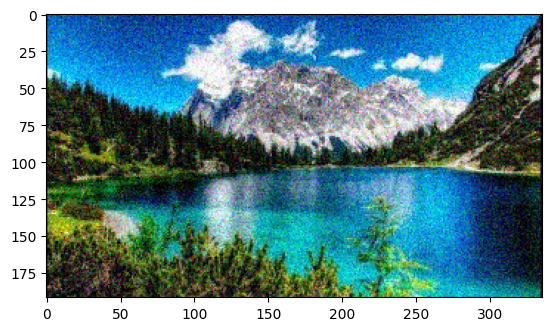

In [ ]:
original_image_bgr = cv2.imread("./image.jpg", cv2.IMREAD_COLOR)
original_image  = cv2.cvtColor(original_image_bgr, cv2.COLOR_BGR2RGB)

img = skimage.util.random_noise(original_image)
plt.imshow(img)

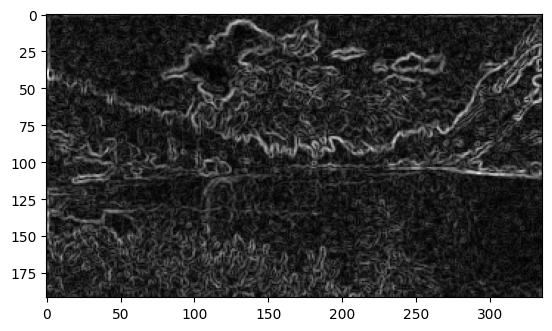

In [ ]:
img_med = med(img, size=2)
img_edge = edge_sobel(img_med)
plt.imshow(img_edge, cmap="gray")

Now let's try with the more blurred gaussian filtered image.

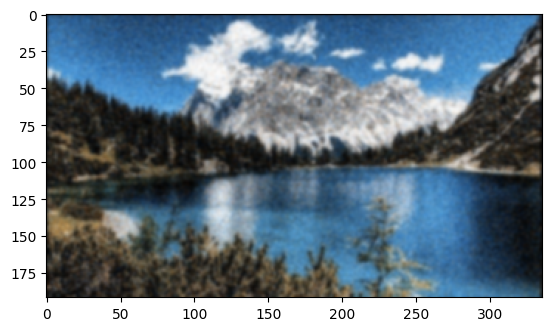

In [ ]:
img_gauss = gauss(img, sigma=1)
plt.imshow(img_gauss)

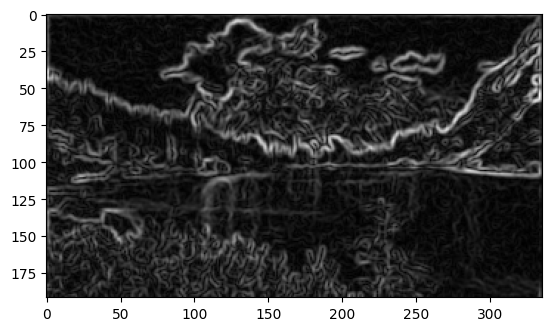

In [ ]:
img_edge = edge_sobel(img_gauss)
plt.imshow(img_edge, cmap="gray")

## Canny Edge Detection <a class="anchor" id="canny" ></a>

Steps:
1. Noise Reduction
2. Gradient Calculation
3. Non-maximum Supression
4. Double Threshold
5. Edge Tracking by Hysteresis

**Pre-requisite:** Convert the image to grayscale before algorithm.

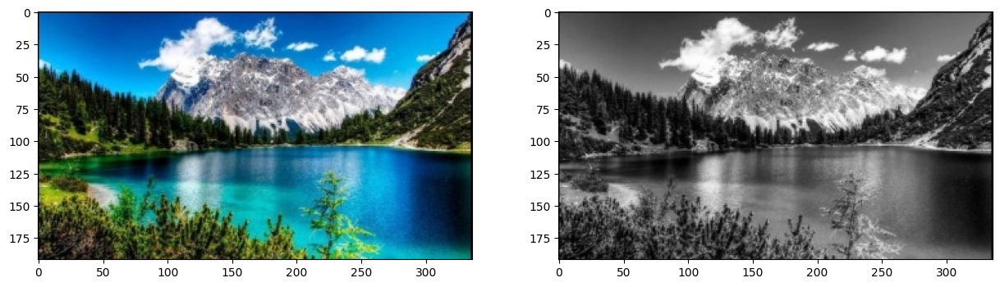

In [ ]:
img = cv2.imread('./image.jpg')

img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_color)
plt.subplot(1, 2, 2)
plt.imshow(img_gray, cmap="gray")

### 1. Noise Reduction
Edge detection are highly sensitive to image noise due to the derivatives behind the algorithm.

We can apply a Gaussian Kernel, the size of the kernel depends on the expected blurring effect. The smaller the less blurring effect.

Equation for Gaussian Kernel of size $(2k+1) \times (2k+1)$

$$
H_{i, j} = \frac{1}{2\pi\sigma^2}exp(-\frac{(i-(k+1))^2 + (j-(k+1))^2}{2\sigma^2}); 1\leq i, j \leq (2k+1)
$$

In [ ]:
def gaussian_kernel(size, sigma=1):
    size = int(size) // 2
    x, y = np.mgrid[-size:size+1, -size:size+1]
    normal = 1 / (2.0 * np.pi * sigma**2)
    g =  np.exp(-((x**2 + y**2) / (2.0*sigma**2))) * normal
    return g

### 1.1 Sigma Parameter $\sigma$

In [ ]:
# Change this parameter
sigma = 10 # 1, 3, 5, 10, 20, ...

### 1.2 Kernel Size Parameter

In [ ]:
kernel_size = 3

#### Sigma = 10

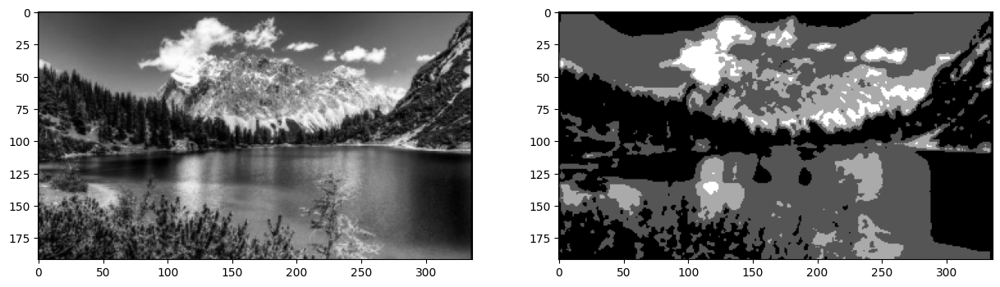

In [ ]:
img_gaussian_sigma_10 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian_sigma_10, cmap="gray")

#### Sigma = 1

In [ ]:
sigma = 1

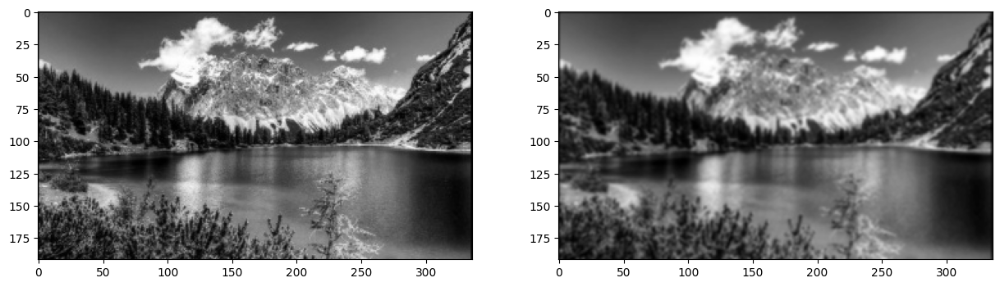

In [ ]:
img_gaussian_sigma_1 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian_sigma_1, cmap="gray")

#### Sigma = 3

In [ ]:
sigma = 3

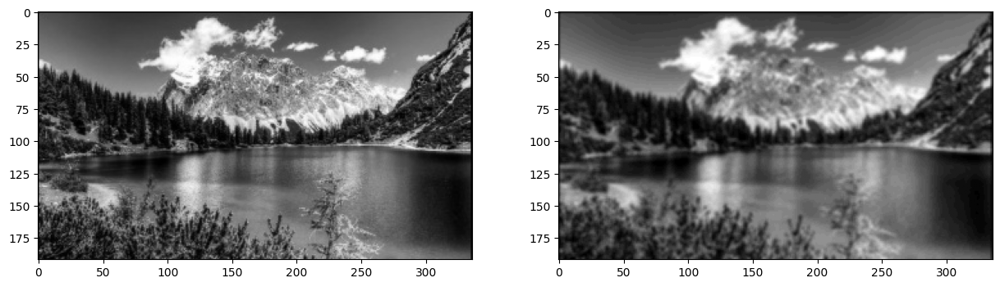

In [ ]:
img_gaussian_sigma_3 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian_sigma_3, cmap="gray")

#### Sigma = 20

In [ ]:
sigma = 20

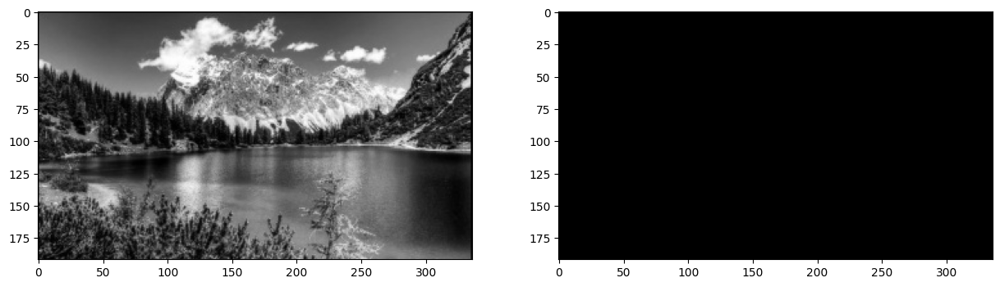

In [ ]:
img_gaussian_sigma_20 = convolve(img_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian_sigma_20, cmap="gray")

### 2. Gradient Calculation

Edges correspond to a change of pixels intensity.

To detect it, the easiest way is to apply filters that highlight this intensity change in both directions:
- horizontal $(x)$
- and vertical $(y)$

It can be implemented by convoling $I$ with *Sobel kernels* $Kx$ and $Ky$

$$
K_x = \begin{bmatrix}
-1 & 0 & 1\\
-2 & 0 & 2\\
-1 & 0 & 1
\end{bmatrix}, K_y = \begin{bmatrix}
1 & 2& 1\\
0 & 0 & 0\\
-1 & -2 & -1
\end{bmatrix}
$$

Then, the magnitude $G$ and the slope $\theta$ of the gradient are calculated as follow:

$$
|G| = \sqrt{I_x^2 + I_y^2},
\theta(x, y) = arctan(\frac{I_y}{I_x})
$$

In [ ]:
def sobel_filters(img):
    Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
    Ky = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)

    Ix = ndimage.filters.convolve(img, Kx)
    Iy = ndimage.filters.convolve(img, Ky)

    G = np.hypot(Ix, Iy)
    G = G / G.max() * 255
    theta = np.arctan2(Iy, Ix)

    return (G, theta)

#### Sigma = 10

/tmp/ipython-input-65442114.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-65442114.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)


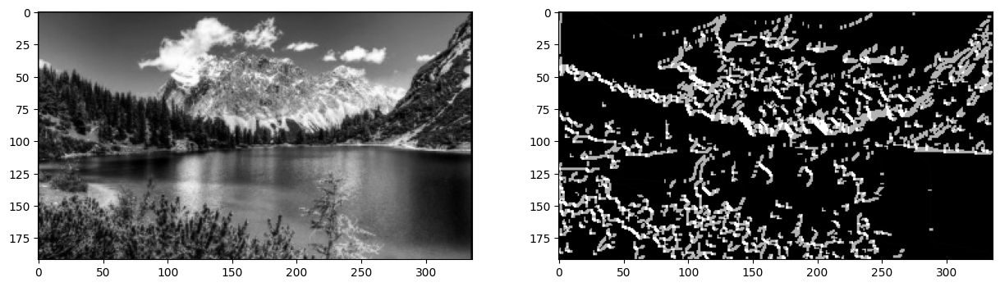

In [ ]:
G_sigma_10, theta_sigma_10 = sobel_filters(img_gaussian_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_sigma_10, cmap="gray")

#### Sigma = 1

/tmp/ipython-input-65442114.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-65442114.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)


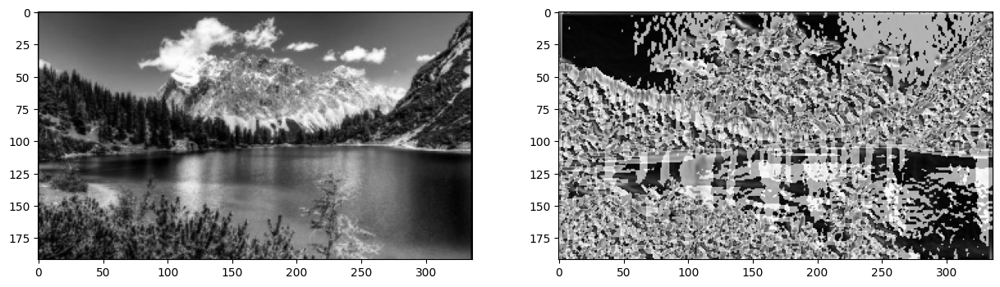

In [ ]:
G_sigma_1, theta_sigma_1 = sobel_filters(img_gaussian_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_sigma_1, cmap="gray")

#### Sigma = 3

/tmp/ipython-input-65442114.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-65442114.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)


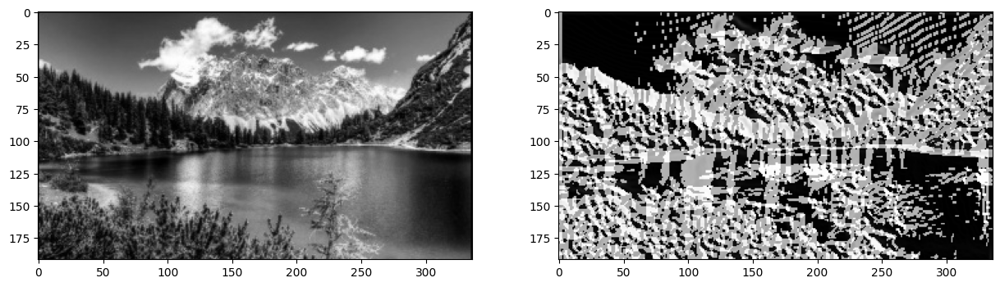

In [ ]:
G_sigma_3, theta_sigma_3 = sobel_filters(img_gaussian_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_sigma_3, cmap="gray")

#### Sigma = 20

/tmp/ipython-input-65442114.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-65442114.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)
/tmp/ipython-input-65442114.py:9: RuntimeWarning: invalid value encountered in divide
  G = G / G.max() * 255


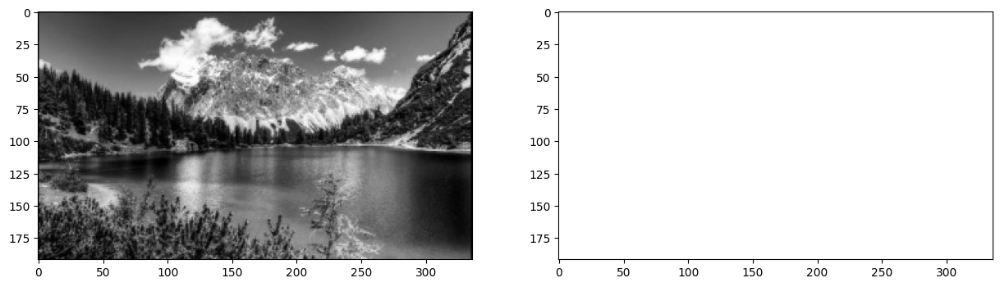

In [ ]:
G_sigma_20, theta_sigma_20 = sobel_filters(img_gaussian_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_sigma_20, cmap="gray")

### 3. Non-Maximum supression

1. Create a matrix initialized to 0 of the same size of the original gradient intensity matrix
2. Identify the edge direction based on the angle value from the angle matrix
3. Check if the pixel in the same direction has a higher intensity than the pixel that is currently processed
4. Return the image processed with the non-max suppression algorithm.

In [ ]:
def non_max_suppression(img, D):
    M, N = img.shape
    Z = np.zeros((M,N), dtype=np.int32)
    angle = D * 180. / np.pi
    angle[angle < 0] += 180


    for i in range(1,M-1):
        for j in range(1,N-1):
            try:
                q = 255
                r = 255

               #angle 0
                if (0 <= angle[i,j] < 22.5) or (157.5 <= angle[i,j] <= 180):
                    q = img[i, j+1]
                    r = img[i, j-1]
                #angle 45
                elif (22.5 <= angle[i,j] < 67.5):
                    q = img[i+1, j-1]
                    r = img[i-1, j+1]
                #angle 90
                elif (67.5 <= angle[i,j] < 112.5):
                    q = img[i+1, j]
                    r = img[i-1, j]
                #angle 135
                elif (112.5 <= angle[i,j] < 157.5):
                    q = img[i-1, j-1]
                    r = img[i+1, j+1]

                if (img[i,j] >= q) and (img[i,j] >= r):
                    Z[i,j] = img[i,j]
                else:
                    Z[i,j] = 0

            except IndexError as e:
                pass

    return Z

#### Sigma = 10

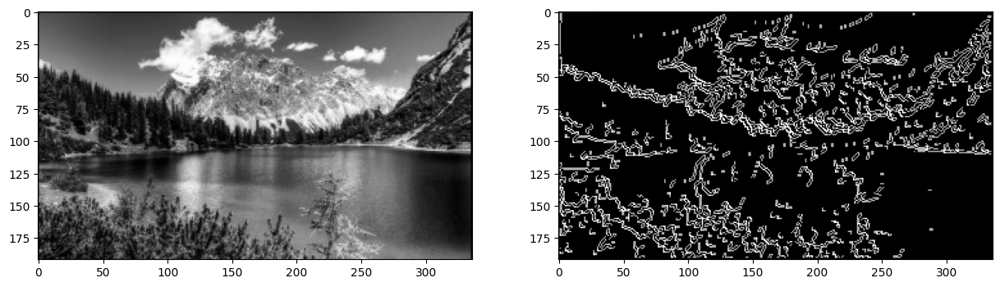

In [ ]:
img_nonmax_sigma_10 = non_max_suppression(G_sigma_10, theta_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax_sigma_10, cmap="gray")

#### Sigma = 1

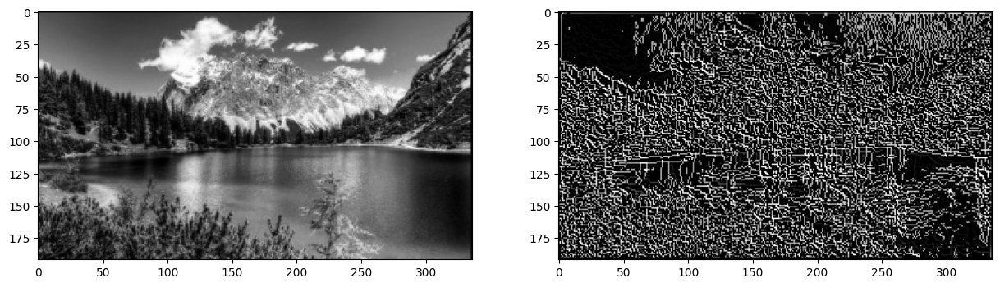

In [ ]:
img_nonmax_sigma_1 = non_max_suppression(G_sigma_1, theta_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax_sigma_1, cmap="gray")

#### Sigma = 3

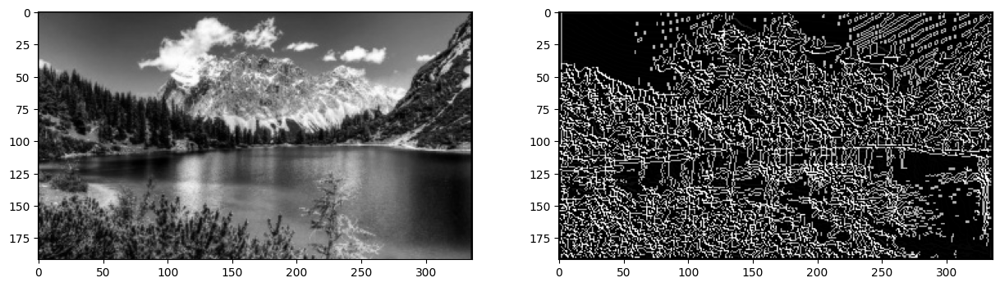

In [ ]:
img_nonmax_sigma_3 = non_max_suppression(G_sigma_3, theta_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax_sigma_3, cmap="gray")

#### Sigma = 20

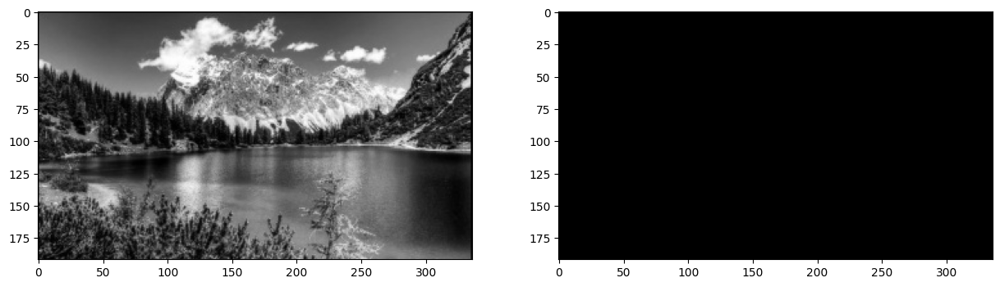

In [ ]:
img_nonmax_sigma_20 = non_max_suppression(G_sigma_20, theta_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax_sigma_20, cmap="gray")

### 4. Double threshold

- Strong pixels are pixels that have an intensity so high that we are sure they contribute to the final edge.
- Weak pixels are pixels that have an intensity value that is not enough to be considered as strong ones, but yet not small enough to be considered as non-relevant for the edge detection.
- Other pixels are considered as non-relevant for the edge.

In [ ]:
def threshold(img, lowThresholdRatio=0.05, highThresholdRatio=0.09):

    highThreshold = img.max() * highThresholdRatio;
    lowThreshold = highThreshold * lowThresholdRatio;

    M, N = img.shape
    res = np.zeros((M,N), dtype=np.int32)

    weak = np.int32(25)
    strong = np.int32(255)

    strong_i, strong_j = np.where(img >= highThreshold)
    zeros_i, zeros_j = np.where(img < lowThreshold)

    weak_i, weak_j = np.where((img <= highThreshold) & (img >= lowThreshold))

    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak

    return (res)

#### Sigma = 10

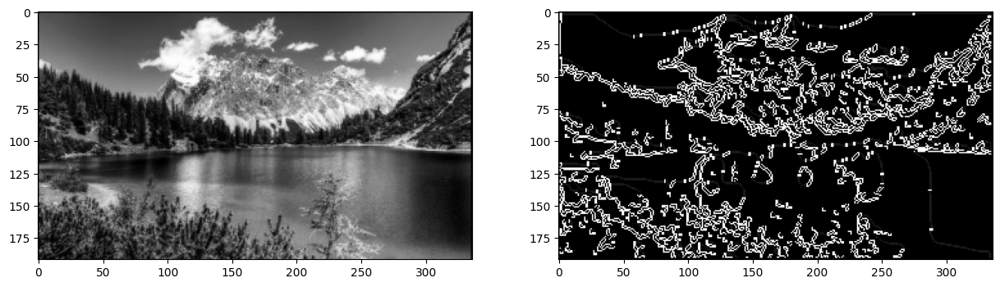

In [ ]:
img_threshold_sigma_10 = threshold(img_nonmax_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold_sigma_10, cmap="gray")

#### Sigma = 1

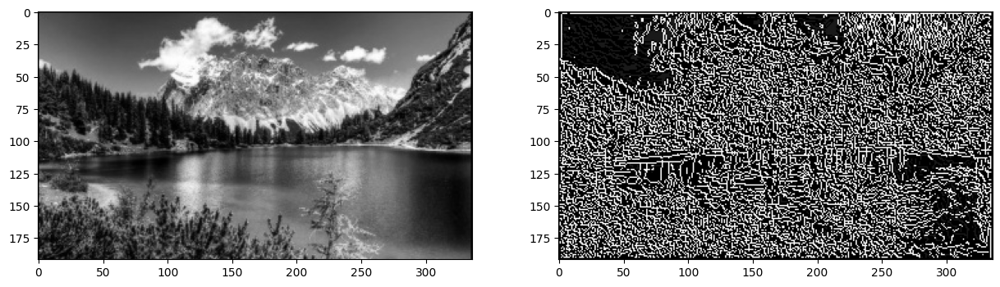

In [ ]:
img_threshold_sigma_1 = threshold(img_nonmax_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold_sigma_1, cmap="gray")

#### Sigma = 3

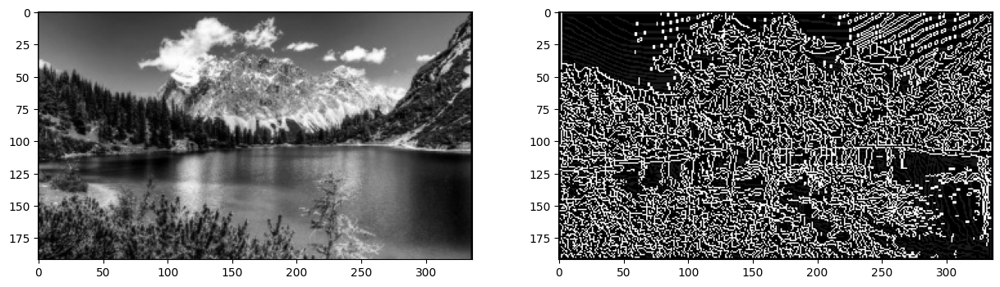

In [ ]:
img_threshold_sigma_3 = threshold(img_nonmax_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold_sigma_3, cmap="gray")

#### Sigma = 20

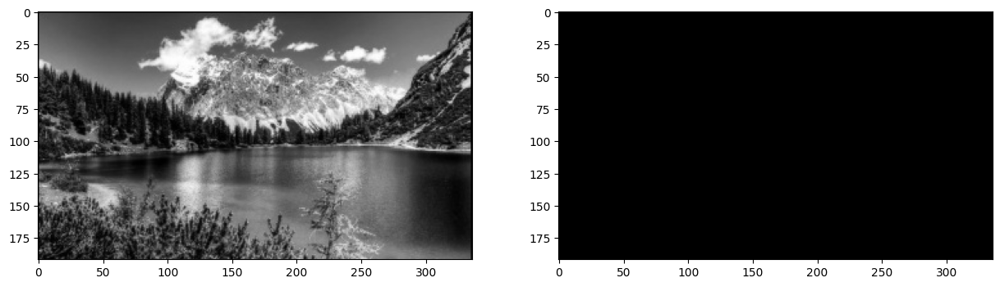

In [ ]:
img_threshold_sigma_20 = threshold(img_nonmax_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold_sigma_20, cmap="gray")

### 5. Edge Tracking by Hysteresis

The hysteresis consists of transforming weak pixels into strong ones, if and only if at least one of the pixels around the one being processed is a strong one

In [ ]:
def hysteresis(img, weak = 75, strong=255):
    M, N = img.shape
    for i in range(1, M-1):
        for j in range(1, N-1):
            if (img[i,j] == weak):
                try:
                    if ((img[i+1, j-1] == strong) or (img[i+1, j] == strong) or (img[i+1, j+1] == strong)
                        or (img[i, j-1] == strong) or (img[i, j+1] == strong)
                        or (img[i-1, j-1] == strong) or (img[i-1, j] == strong) or (img[i-1, j+1] == strong)):
                        img[i, j] = strong
                    else:
                        img[i, j] = 0
                except IndexError as e:
                    pass
    return img

#### Sigma=10

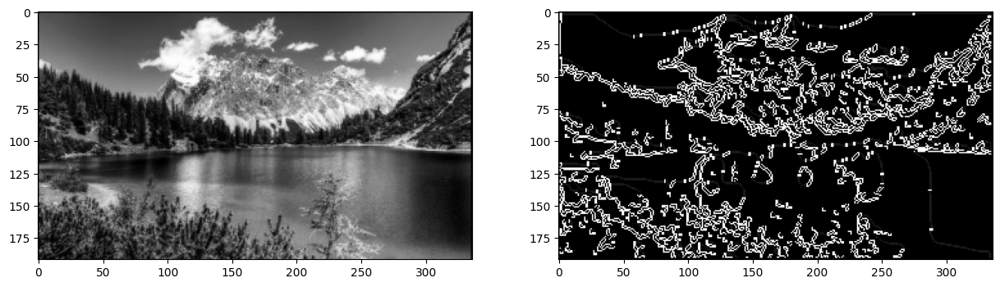

In [ ]:
img_final_sigma_10 = hysteresis(img_threshold_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final_sigma_10, cmap="gray")

#### Sigma=1

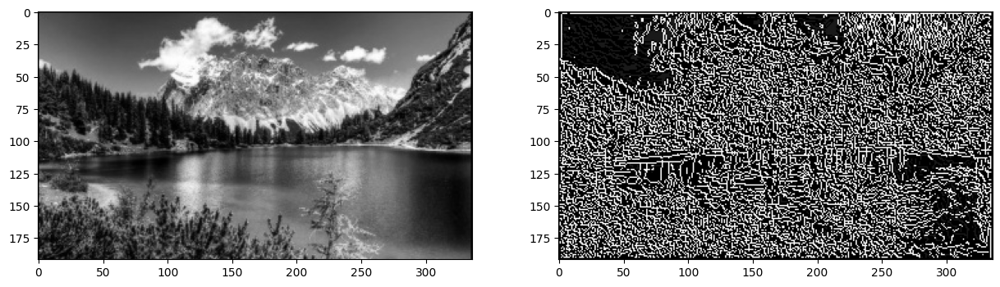

In [ ]:
img_final_sigma_1 = hysteresis(img_threshold_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final_sigma_1, cmap="gray")

#### Sigma=3

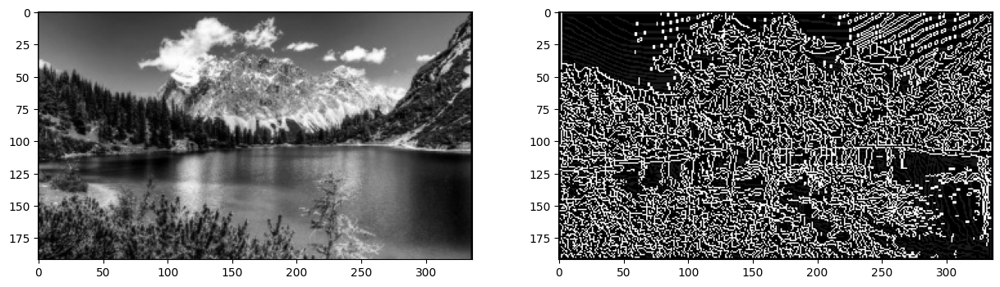

In [ ]:
img_final_sigma_3 = hysteresis(img_threshold_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final_sigma_3, cmap="gray")

#### Sigma=20

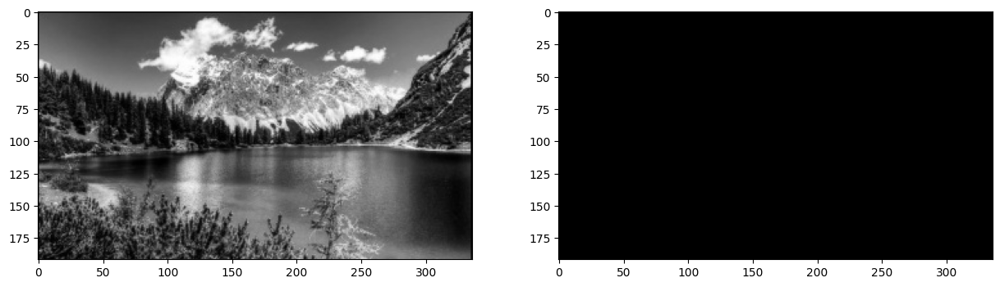

In [ ]:
img_final_sigma_20 = hysteresis(img_threshold_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final_sigma_20, cmap="gray")

## Canny Edge Detection No Noise reduction <a class="anchor" id="canny_no_noise" ></a>

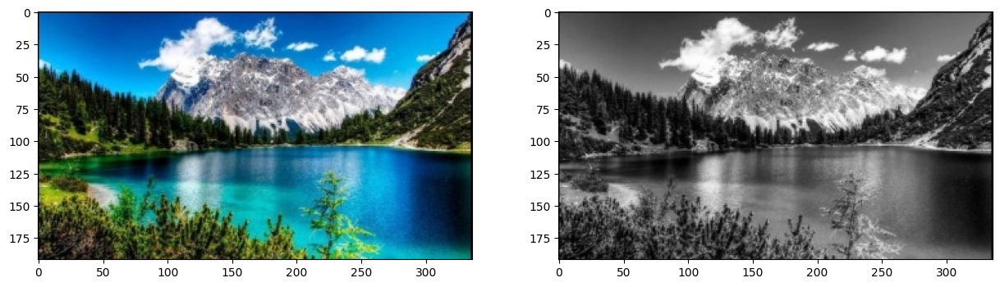

In [ ]:
img = cv2.imread('./image.jpg')

img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_color)
plt.subplot(1, 2, 2)
plt.imshow(img_gray, cmap="gray")

### 1. Gradient Calculation

Edges correspond to a change of pixels intensity.

To detect it, the easiest way is to apply filters that highlight this intensity change in both directions:
- horizontal $(x)$
- and vertical $(y)$

It can be implemented by convoling $I$ with *Sobel kernels* $Kx$ and $Ky$

$$
K_x = \begin{bmatrix}
-1 & 0 & 1\\
-2 & 0 & 2\\
-1 & 0 & 1
\end{bmatrix}, K_y = \begin{bmatrix}
1 & 2& 1\\
0 & 0 & 0\\
-1 & -2 & -1
\end{bmatrix}
$$

Then, the magnitude $G$ and the slope $\theta$ of the gradient are calculated as follow:

$$
|G| = \sqrt{I_x^2 + I_y^2},
\theta(x, y) = arctan(\frac{I_y}{I_x})
$$

In [ ]:
def sobel_filters(img):
    Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
    Ky = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)

    Ix = ndimage.filters.convolve(img, Kx)
    Iy = ndimage.filters.convolve(img, Ky)

    G = np.hypot(Ix, Iy)
    G = G / G.max() * 255
    theta = np.arctan2(Iy, Ix)

    return (G, theta)

/tmp/ipython-input-65442114.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-65442114.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)


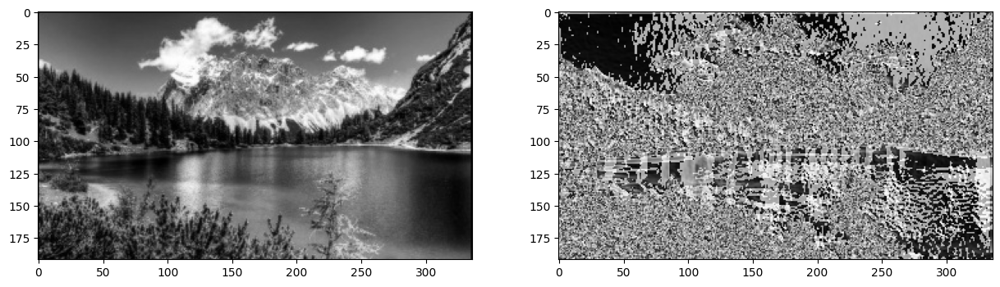

In [ ]:
G_no_noise, theta_no_noise = sobel_filters(img_gray)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_no_noise, cmap="gray")

### 2. Non-Maximum supression

1. Create a matrix initialized to 0 of the same size of the original gradient intensity matrix
2. Identify the edge direction based on the angle value from the angle matrix
3. Check if the pixel in the same direction has a higher intensity than the pixel that is currently processed
4. Return the image processed with the non-max suppression algorithm.

In [ ]:
def non_max_suppression(img, D):
    M, N = img.shape
    Z = np.zeros((M,N), dtype=np.int32)
    angle = D * 180. / np.pi
    angle[angle < 0] += 180


    for i in range(1,M-1):
        for j in range(1,N-1):
            try:
                q = 255
                r = 255

               #angle 0
                if (0 <= angle[i,j] < 22.5) or (157.5 <= angle[i,j] <= 180):
                    q = img[i, j+1]
                    r = img[i, j-1]
                #angle 45
                elif (22.5 <= angle[i,j] < 67.5):
                    q = img[i+1, j-1]
                    r = img[i-1, j+1]
                #angle 90
                elif (67.5 <= angle[i,j] < 112.5):
                    q = img[i+1, j]
                    r = img[i-1, j]
                #angle 135
                elif (112.5 <= angle[i,j] < 157.5):
                    q = img[i-1, j-1]
                    r = img[i+1, j+1]

                if (img[i,j] >= q) and (img[i,j] >= r):
                    Z[i,j] = img[i,j]
                else:
                    Z[i,j] = 0

            except IndexError as e:
                pass

    return Z

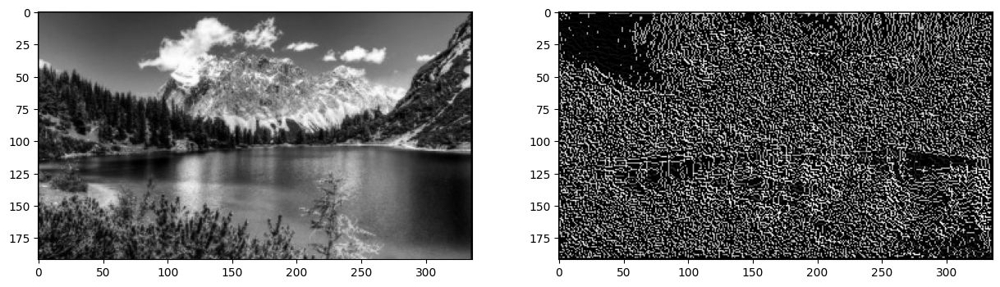

In [ ]:
img_nonmax_no_noise = non_max_suppression(G_no_noise, theta_no_noise)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_nonmax_no_noise, cmap="gray")

### 3. Double threshold

- Strong pixels are pixels that have an intensity so high that we are sure they contribute to the final edge.
- Weak pixels are pixels that have an intensity value that is not enough to be considered as strong ones, but yet not small enough to be considered as non-relevant for the edge detection.
- Other pixels are considered as non-relevant for the edge.

In [ ]:
def threshold(img, lowThresholdRatio=0.05, highThresholdRatio=0.09):

    highThreshold = img.max() * highThresholdRatio;
    lowThreshold = highThreshold * lowThresholdRatio;

    M, N = img.shape
    res = np.zeros((M,N), dtype=np.int32)

    weak = np.int32(25)
    strong = np.int32(255)

    strong_i, strong_j = np.where(img >= highThreshold)
    zeros_i, zeros_j = np.where(img < lowThreshold)

    weak_i, weak_j = np.where((img <= highThreshold) & (img >= lowThreshold))

    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak

    return (res)

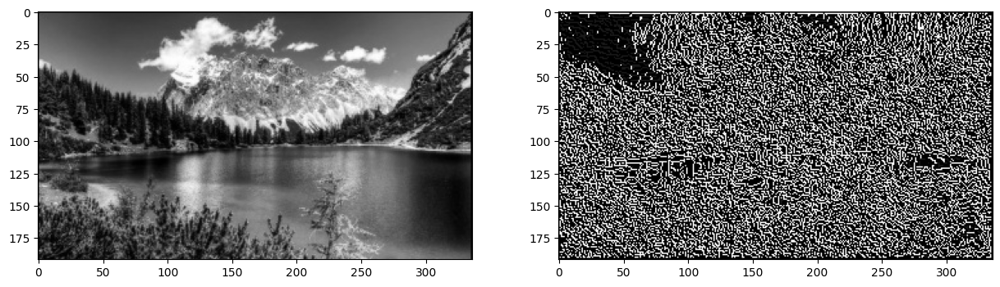

In [ ]:
img_threshold_no_noise = threshold(img_nonmax_no_noise)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_threshold_no_noise, cmap="gray")

### 4. Edge Tracking by Hysteresis

The hysteresis consists of transforming weak pixels into strong ones, if and only if at least one of the pixels around the one being processed is a strong one

In [ ]:
def hysteresis(img, weak = 75, strong=255):
    M, N = img.shape
    for i in range(1, M-1):
        for j in range(1, N-1):
            if (img[i,j] == weak):
                try:
                    if ((img[i+1, j-1] == strong) or (img[i+1, j] == strong) or (img[i+1, j+1] == strong)
                        or (img[i, j-1] == strong) or (img[i, j+1] == strong)
                        or (img[i-1, j-1] == strong) or (img[i-1, j] == strong) or (img[i-1, j+1] == strong)):
                        img[i, j] = strong
                    else:
                        img[i, j] = 0
                except IndexError as e:
                    pass
    return img

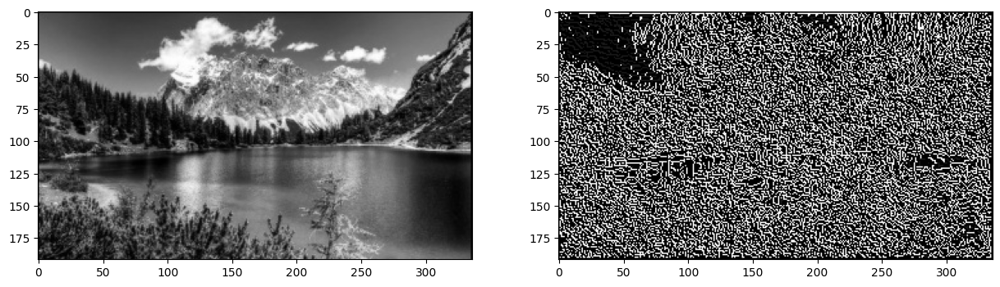

In [ ]:
img_final_no_noise = hysteresis(img_threshold_no_noise)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_final_no_noise, cmap="gray")

## Canny Edge Detection New Image <a class="anchor" id="canny_new_image" ></a>

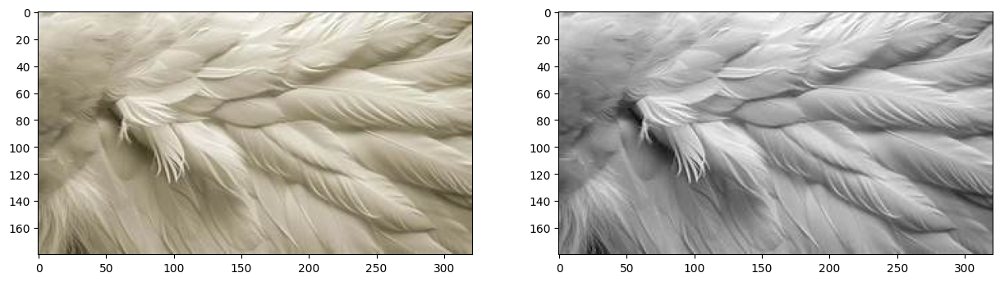

In [ ]:
img_plumas = cv2.imread('./plumas.jpg')

img_plumas_color = cv2.cvtColor(img_plumas, cv2.COLOR_BGR2RGB)
img_plumas_gray = cv2.cvtColor(img_plumas, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_color)
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_gray, cmap="gray")

### 1. Noise Reduction
Edge detection are highly sensitive to image noise due to the derivatives behind the algorithm.

We can apply a Gaussian Kernel, the size of the kernel depends on the expected blurring effect. The smaller the less blurring effect.

Equation for Gaussian Kernel of size $(2k+1) \times (2k+1)$

$$
H_{i, j} = \frac{1}{2\pi\sigma^2}exp(-\frac{(i-(k+1))^2 + (j-(k+1))^2}{2\sigma^2}); 1\leq i, j \leq (2k+1)
$$

In [ ]:
def gaussian_kernel(size, sigma=1):
    size = int(size) // 2
    x, y = np.mgrid[-size:size+1, -size:size+1]
    normal = 1 / (2.0 * np.pi * sigma**2)
    g =  np.exp(-((x**2 + y**2) / (2.0*sigma**2))) * normal
    return g

### 1.1 Sigma Parameter $\sigma$

In [ ]:
# Change this parameter
sigma = 10 # 1, 3, 5, 10, 20, ...

### 1.2 Kernel Size Parameter

In [ ]:
kernel_size = 3

#### Sigma = 10

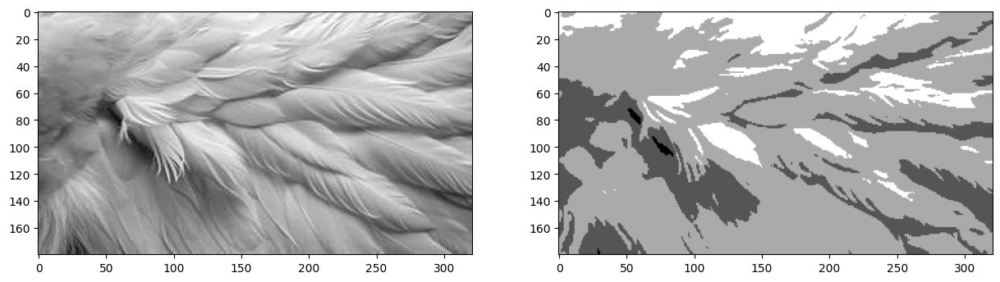

In [ ]:
img_plumas_gaussian_sigma_10 = convolve(img_plumas_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_gaussian_sigma_10, cmap="gray")

#### Sigma = 1

In [ ]:
sigma = 1

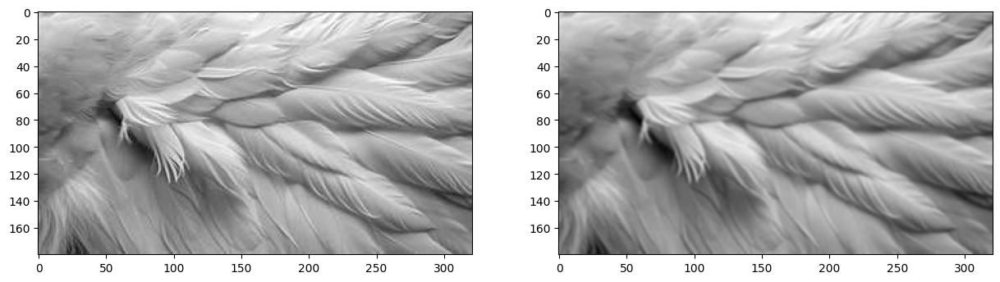

In [ ]:
img_plumas_gaussian_sigma_1 = convolve(img_plumas_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_gaussian_sigma_1, cmap="gray")

#### Sigma = 3

In [ ]:
sigma = 3

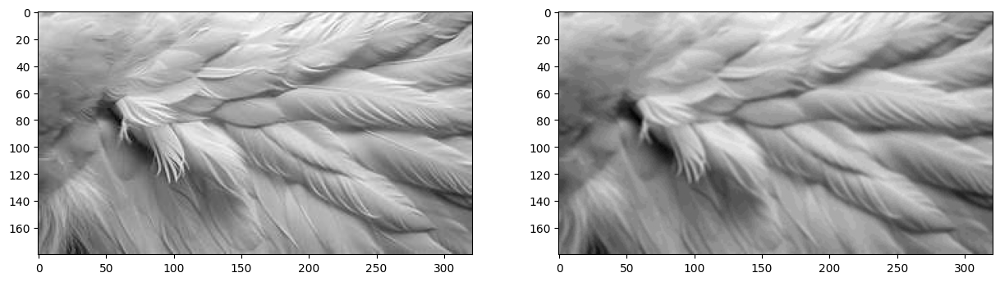

In [ ]:
img_plumas_gaussian_sigma_3 = convolve(img_plumas_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_gaussian_sigma_3, cmap="gray")

#### Sigma = 20

In [ ]:
sigma = 20

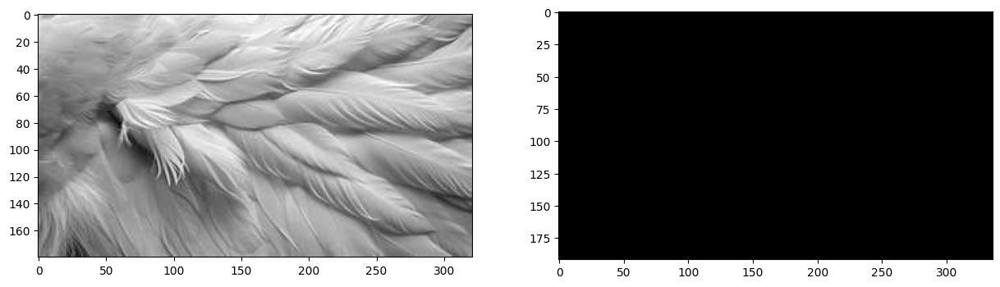

In [ ]:
img_plumas_gaussian_sigma_20 = convolve(img_plumas_gray, gaussian_kernel(kernel_size, sigma))

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_gaussian_sigma_20, cmap="gray")

### 2. Gradient Calculation

Edges correspond to a change of pixels intensity.

To detect it, the easiest way is to apply filters that highlight this intensity change in both directions:
- horizontal $(x)$
- and vertical $(y)$

It can be implemented by convoling $I$ with *Sobel kernels* $Kx$ and $Ky$

$$
K_x = \begin{bmatrix}
-1 & 0 & 1\\
-2 & 0 & 2\\
-1 & 0 & 1
\end{bmatrix}, K_y = \begin{bmatrix}
1 & 2& 1\\
0 & 0 & 0\\
-1 & -2 & -1
\end{bmatrix}
$$

Then, the magnitude $G$ and the slope $\theta$ of the gradient are calculated as follow:

$$
|G| = \sqrt{I_x^2 + I_y^2},
\theta(x, y) = arctan(\frac{I_y}{I_x})
$$

In [ ]:
def sobel_filters(img):
    Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
    Ky = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)

    Ix = ndimage.filters.convolve(img, Kx)
    Iy = ndimage.filters.convolve(img, Ky)

    G = np.hypot(Ix, Iy)
    G = G / G.max() * 255
    theta = np.arctan2(Iy, Ix)

    return (G, theta)

#### Sigma = 10

/tmp/ipython-input-3134136643.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-3134136643.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)


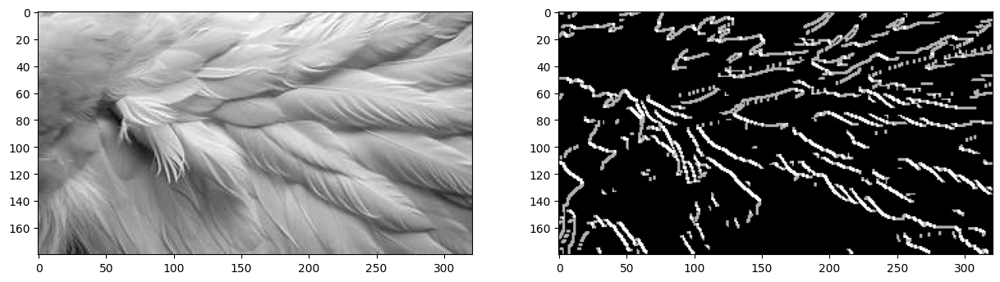

In [ ]:
G_plumas_sigma_10, theta_plumas_sigma_10 = sobel_filters(img_plumas_gaussian_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_plumas_sigma_10, cmap="gray")

#### Sigma = 1

/tmp/ipython-input-3134136643.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-3134136643.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)


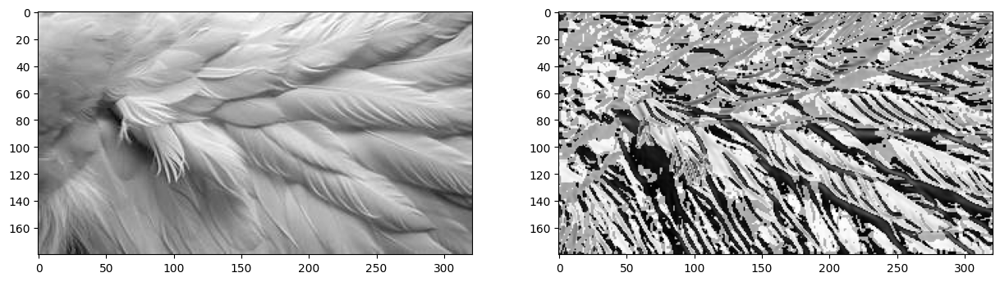

In [ ]:
G_plumas_sigma_1, theta_plumas_sigma_1 = sobel_filters(img_plumas_gaussian_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_plumas_sigma_1, cmap="gray")

#### Sigma = 3

/tmp/ipython-input-3134136643.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-3134136643.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)


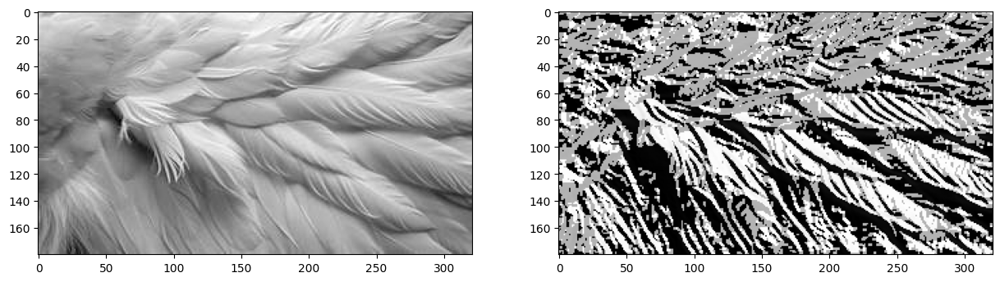

In [ ]:
G_plumas_sigma_3, theta_plumas_sigma_3 = sobel_filters(img_plumas_gaussian_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_plumas_sigma_3, cmap="gray")

#### Sigma = 20

/tmp/ipython-input-3134136643.py:5: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Ix = ndimage.filters.convolve(img, Kx)
/tmp/ipython-input-3134136643.py:6: DeprecationWarning: Please import `convolve` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  Iy = ndimage.filters.convolve(img, Ky)
/tmp/ipython-input-3134136643.py:9: RuntimeWarning: invalid value encountered in divide
  G = G / G.max() * 255


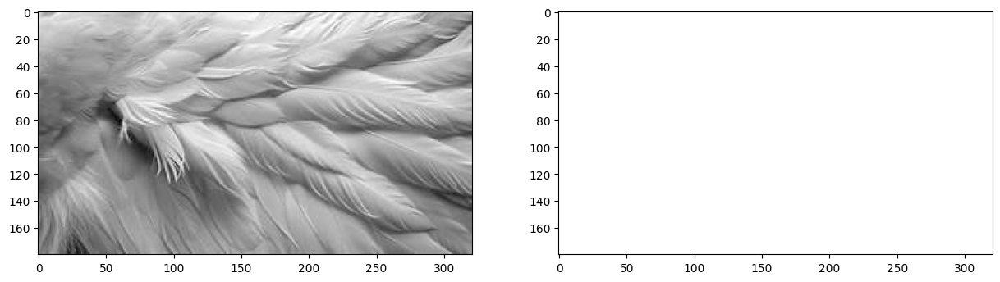

In [ ]:
G_plumas_sigma_20, theta_plumas_sigma_20 = sobel_filters(img_plumas_gaussian_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(G_plumas_sigma_20, cmap="gray")

### 3. Non-Maximum supression

1. Create a matrix initialized to 0 of the same size of the original gradient intensity matrix
2. Identify the edge direction based on the angle value from the angle matrix
3. Check if the pixel in the same direction has a higher intensity than the pixel that is currently processed
4. Return the image processed with the non-max suppression algorithm.

In [ ]:
def non_max_suppression(img, D):
    M, N = img.shape
    Z = np.zeros((M,N), dtype=np.int32)
    angle = D * 180. / np.pi
    angle[angle < 0] += 180


    for i in range(1,M-1):
        for j in range(1,N-1):
            try:
                q = 255
                r = 255

               #angle 0
                if (0 <= angle[i,j] < 22.5) or (157.5 <= angle[i,j] <= 180):
                    q = img[i, j+1]
                    r = img[i, j-1]
                #angle 45
                elif (22.5 <= angle[i,j] < 67.5):
                    q = img[i+1, j-1]
                    r = img[i-1, j+1]
                #angle 90
                elif (67.5 <= angle[i,j] < 112.5):
                    q = img[i+1, j]
                    r = img[i-1, j]
                #angle 135
                elif (112.5 <= angle[i,j] < 157.5):
                    q = img[i-1, j-1]
                    r = img[i+1, j+1]

                if (img[i,j] >= q) and (img[i,j] >= r):
                    Z[i,j] = img[i,j]
                else:
                    Z[i,j] = 0

            except IndexError as e:
                pass

    return Z

#### Sigma = 10

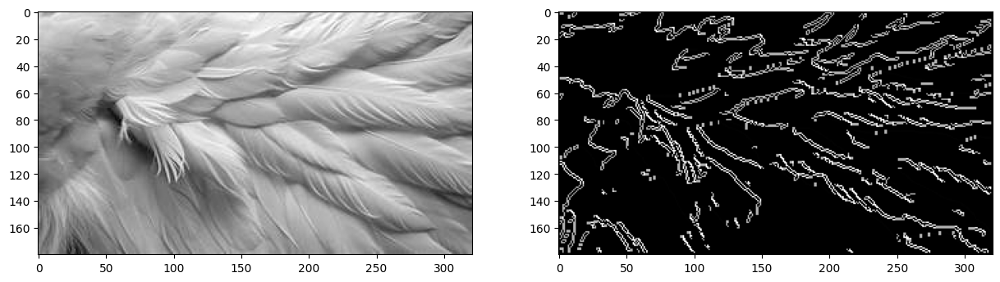

In [ ]:
img_plumas_nonmax_sigma_10 = non_max_suppression(G_plumas_sigma_10, theta_plumas_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_nonmax_sigma_10, cmap="gray")

#### Sigma = 1

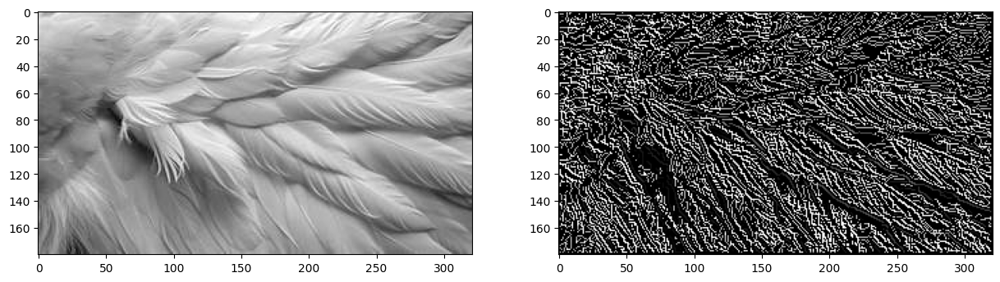

In [ ]:
img_plumas_nonmax_sigma_1 = non_max_suppression(G_plumas_sigma_1, theta_plumas_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_nonmax_sigma_1, cmap="gray")

#### Sigma = 3

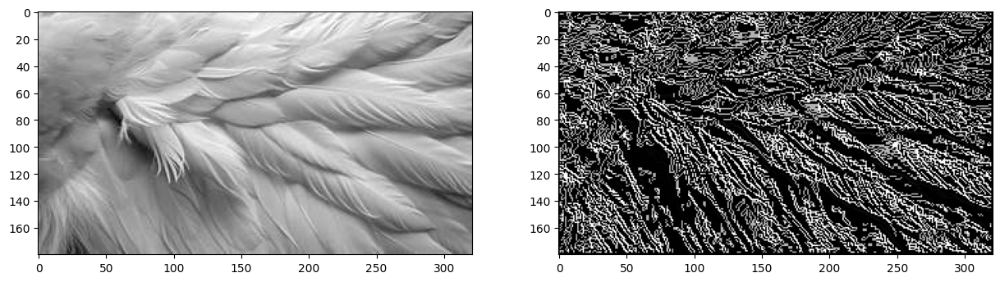

In [ ]:
img_plumas_nonmax_sigma_3 = non_max_suppression(G_plumas_sigma_3, theta_plumas_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_nonmax_sigma_3, cmap="gray")

#### Sigma = 20

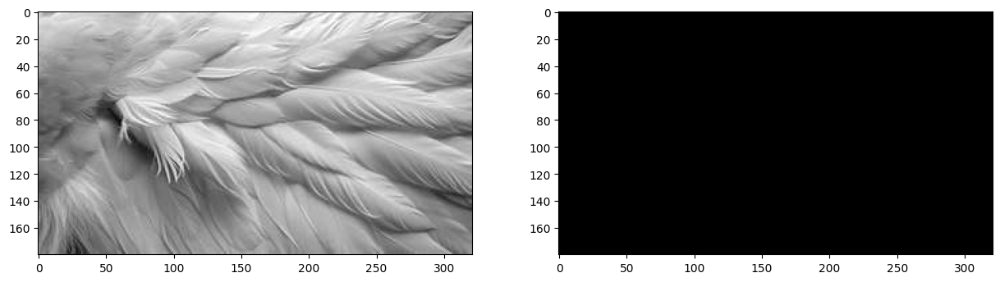

In [ ]:
img_plumas_nonmax_sigma_20 = non_max_suppression(G_plumas_sigma_20, theta_plumas_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_nonmax_sigma_20, cmap="gray")

### 4. Double threshold

- Strong pixels are pixels that have an intensity so high that we are sure they contribute to the final edge.
- Weak pixels are pixels that have an intensity value that is not enough to be considered as strong ones, but yet not small enough to be considered as non-relevant for the edge detection.
- Other pixels are considered as non-relevant for the edge.

In [ ]:
def threshold(img, lowThresholdRatio=0.05, highThresholdRatio=0.09):

    highThreshold = img.max() * highThresholdRatio;
    lowThreshold = highThreshold * lowThresholdRatio;

    M, N = img.shape
    res = np.zeros((M,N), dtype=np.int32)

    weak = np.int32(25)
    strong = np.int32(255)

    strong_i, strong_j = np.where(img >= highThreshold)
    zeros_i, zeros_j = np.where(img < lowThreshold)

    weak_i, weak_j = np.where((img <= highThreshold) & (img >= lowThreshold))

    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak

    return (res)

#### Sigma = 10

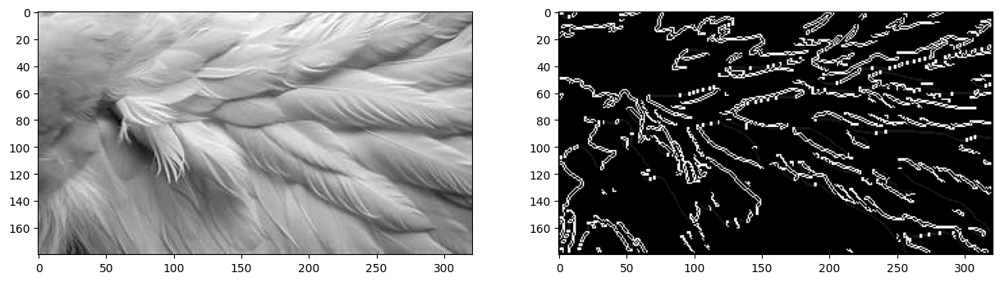

In [ ]:
img_plumas_threshold_sigma_10 = threshold(img_plumas_nonmax_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_threshold_sigma_10, cmap="gray")

#### Sigma = 1

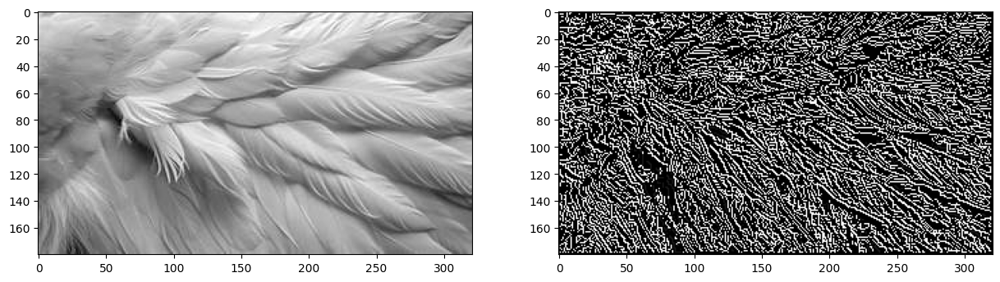

In [ ]:
img_plumas_threshold_sigma_1 = threshold(img_plumas_nonmax_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_threshold_sigma_1, cmap="gray")

#### Sigma = 3

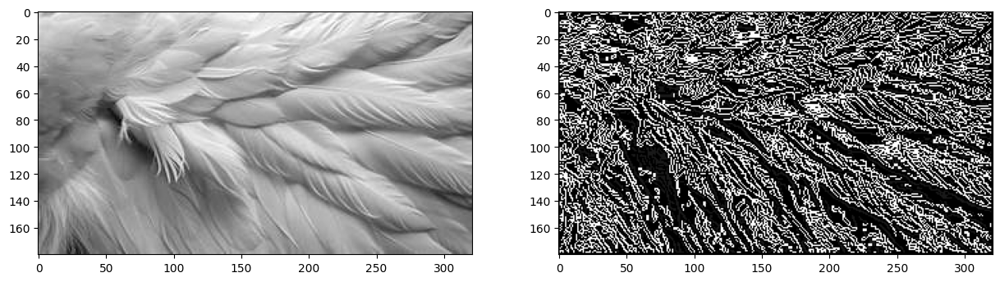

In [ ]:
img_plumas_threshold_sigma_3 = threshold(img_plumas_nonmax_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_threshold_sigma_3, cmap="gray")

#### Sigma = 20

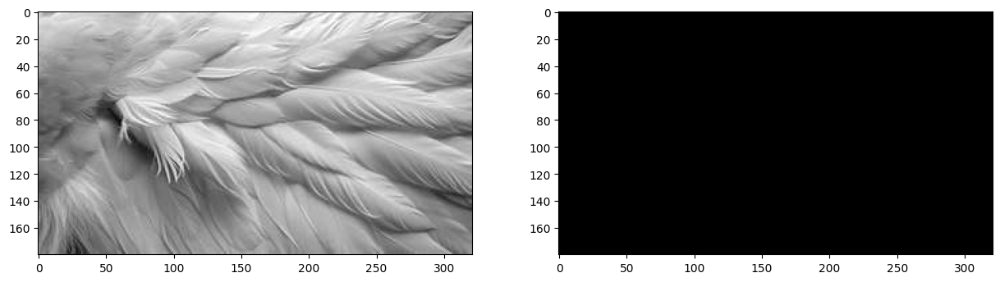

In [ ]:
img_plumas_threshold_sigma_20 = threshold(img_plumas_nonmax_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_threshold_sigma_20, cmap="gray")

### 5. Edge Tracking by Hysteresis

The hysteresis consists of transforming weak pixels into strong ones, if and only if at least one of the pixels around the one being processed is a strong one

In [ ]:
def hysteresis(img, weak = 75, strong=255):
    M, N = img.shape
    for i in range(1, M-1):
        for j in range(1, N-1):
            if (img[i,j] == weak):
                try:
                    if ((img[i+1, j-1] == strong) or (img[i+1, j] == strong) or (img[i+1, j+1] == strong)
                        or (img[i, j-1] == strong) or (img[i, j+1] == strong)
                        or (img[i-1, j-1] == strong) or (img[i-1, j] == strong) or (img[i-1, j+1] == strong)):
                        img[i, j] = strong
                    else:
                        img[i, j] = 0
                except IndexError as e:
                    pass
    return img

#### Sigma=10

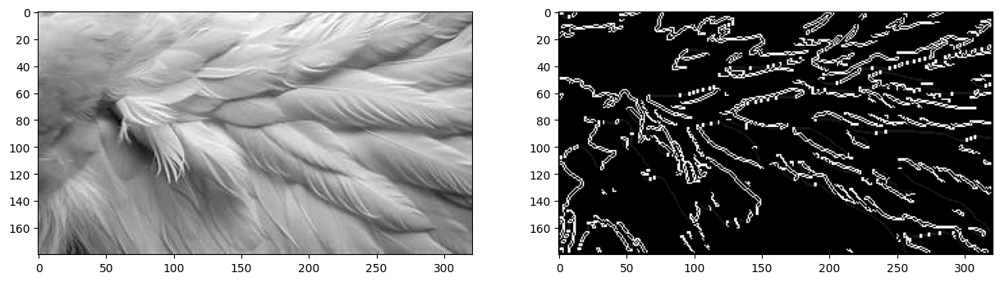

In [ ]:
img_plumas_final_sigma_10 = hysteresis(img_plumas_threshold_sigma_10)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_final_sigma_10, cmap="gray")

#### Sigma=1

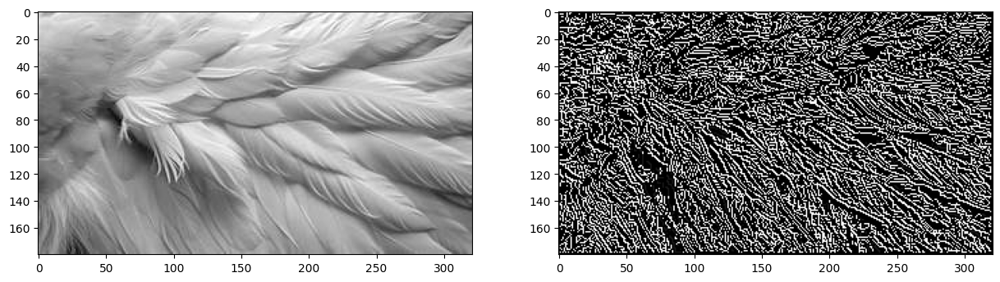

In [ ]:
img_plumas_final_sigma_1 = hysteresis(img_plumas_threshold_sigma_1)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_final_sigma_1, cmap="gray")

#### Sigma=3

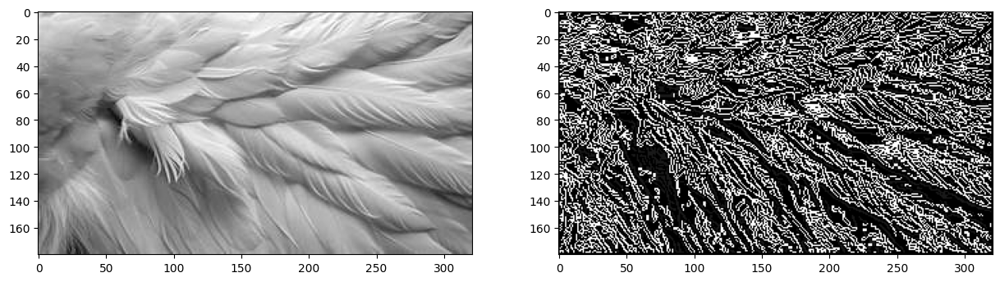

In [ ]:
img_plumas_final_sigma_3 = hysteresis(img_plumas_threshold_sigma_3)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_final_sigma_3, cmap="gray")

#### Sigma=20

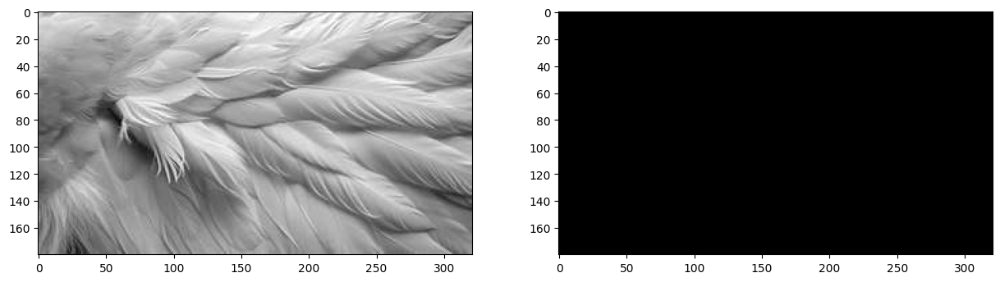

In [ ]:
img_plumas_final_sigma_20 = hysteresis(img_plumas_threshold_sigma_20)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_plumas_gray, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(img_plumas_final_sigma_20, cmap="gray")

## Resultados

A continuación, se resumen los principales hallazgos y el impacto de la modificación de parámetros en los resultados del procesamiento de imágenes, específicamente en la Detección de Bordes con Canny y la Detección de Líneas con Hough.

## Impacto del Parámetro σ (Sigma)
El valor de Sigma (σ) en el filtro Gaussiano actúa como el principal factor de trade-off entre suavizado y preservación de detalles. Al usar un valor de σ bajo (p. ej., menor a 1), el suavizado es mínimo, lo que resulta en bordes detectados más finos y detallados, pero también hace que el algoritmo sea muy sensible al ruido de la imagen, detectando bordes espurios. Por el contrario, un valor de σ alto (p. ej., mayor a 2) elimina el ruido de manera efectiva, pero a costa de engrosar y fusionar los bordes cercanos, lo que puede provocar la pérdida de detalles finos y texturas importantes.

## Comportamiento del Canny Detector con y sin Ruido
La etapa de remoción de ruido mediante el filtro Gaussiano demostró ser crítica para el desempeño del Canny Detector. Cuando se aplica la remoción de ruido, los bordes resultantes son limpios, continuos y coherentes, lo que facilita las etapas subsiguientes (como la detección de líneas). Sin embargo, al omitir el suavizado inicial, el detector de Canny produce un mapa de bordes extremadamente fragmentado y ruidoso, lleno de falsos positivos y discontinuidades, haciendo que el resultado sea poco útil para la mayoría de las tareas de visión por computador.

## Efecto de la Textura y el Número de Líneas
Se observó una gran dependencia del rendimiento del algoritmo de detección de líneas (Hough) respecto a la complejidad de la imagen. En imágenes simples con pocos objetos o baja textura (como diagramas), el algoritmo funciona de manera óptima, detectando las líneas con alta precisión. En contraste, las imágenes con alta textura (p. ej., imágenes de naturaleza o patrones repetitivos) generan una gran cantidad de bordes detectados por Canny. Este exceso de información provoca que el algoritmo de Hough se sature, volviéndose muy lento y produciendo una enorme cantidad de líneas irrelevantes, lo que dificulta la extracción de las líneas principales deseadas.

**Referencias**


* Gonzalez, R. C., & Woods, R. E. (2018). Digital Image Processing (4th ed.). Pearson.

* OpenCV: Canny Edge Detection. (n.d.). https://docs.opencv.org/4.x/da/d22/tutorial_py_canny.html

* OpenCV: Canny Edge Detector. (n.d.). https://docs.opencv.org/3.4/da/d5c/tutorial_canny_detector.html

* Rosebrock, A. (2023, June 8). OpenCV Edge Detection ( Cv2.Canny ) - PyImageSearch. PyImageSearch. https://pyimagesearch.com/2021/05/12/opencv-edge-detection-cv2-canny/